## Salary Prediction Case Study - Part I ( Exploratory Data Analysis)

#### Prepared by : Kousik Das

<img src="https://cdn.hrpayrollsystems.net/wp-content/uploads/2020/01/Depositphotos_55140233_s-2019.jpg"/>

### Table of Contents:
### [1. Problem Statement ](#problem)
### [2. Loading Datasets](#loading)
### [3. Sample Data : How the dataset looks like](#sample)
### [4. Data Analysis : Data Insights](#dadi)
### [5. Understanding target variable in Detail](#target)
### [6. Data Visualization : Graphical way for More Insights](#dv)

<a id='problem'></a>
### 1. Problem Statement

Based on certain atributes for a Job, a model is required which can prdict salaray for a person for whom we know some other similar information.

This report is divided in below parts. In first section , some Exploratory Data Analysis has been shown to understand and strategise the model design in effective way.

1. Loading Available datasets and examine Summary Statistics

2. Understanding Data through Exploratory Data Analysis

3. Designing a efficient Machine Learning Model to predict Salary 

In [1]:
### Importing necessary basic Python Packages, modules
#--- Numpy, Pandas for Data Loading and Analysis;
#--- Matplotlib,seaborn and klib for Data Visualization
### Other packages and modules will be imported as necessary

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import klib  
import warnings
%matplotlib inline
warnings.filterwarnings("ignore")


<a id='loading'></a>
### 2. Loading Datasets

Three datasets are avaialable for this Business Problem.

1. Dataset to train the Model : train_features.csv

2. Dataset to test the Model: test_features.csv

3. Salary Information for Training dataset: train_salaries.csv



In [2]:
train_features_df= pd.read_csv("train_features.csv")
test_features_df= pd.read_csv("test_features.csv")
train_salaries_df= pd.read_csv("train_salaries.csv")

<a id='sample'></a>
### 3. Sample Data : How the dataset looks like

#### 3.1. Sample Training Dataset

Let's have a look on the actual dataset to get a primary understanding and idea to stratigise next coarse of actions.

In [3]:
train_features_df.head()


,jobId,companyId,jobType,degree,major,industry,yearsExperience,milesFromMetropolis
0,JOB1362684407687,COMP37,CFO,MASTERS,MATH,HEALTH,10,83
1,JOB1362684407688,COMP19,CEO,HIGH_SCHOOL,NONE,WEB,3,73
2,JOB1362684407689,COMP52,VICE_PRESIDENT,DOCTORAL,PHYSICS,HEALTH,10,38
3,JOB1362684407690,COMP38,MANAGER,DOCTORAL,CHEMISTRY,AUTO,8,17
4,JOB1362684407691,COMP7,VICE_PRESIDENT,BACHELORS,PHYSICS,FINANCE,8,16


#### 3.2. Sample Test Data Set

In [4]:
test_features_df.head()

,jobId,companyId,jobType,degree,major,industry,yearsExperience,milesFromMetropolis
0,JOB1362685407687,COMP33,MANAGER,HIGH_SCHOOL,NONE,HEALTH,22,73
1,JOB1362685407688,COMP13,JUNIOR,NONE,NONE,AUTO,20,47
2,JOB1362685407689,COMP10,CTO,MASTERS,BIOLOGY,HEALTH,17,9
3,JOB1362685407690,COMP21,MANAGER,HIGH_SCHOOL,NONE,OIL,14,96
4,JOB1362685407691,COMP36,JUNIOR,DOCTORAL,BIOLOGY,OIL,10,44


Taining Dataset and Testing data set are identical in structure. First one will be used to train model and test set will be helpful to evaluate and decide on final model.

#### 3.3. Sample data for Salary(Target) corresponding to Training set

In [5]:
train_salaries_df.head()

,jobId,salary
0,JOB1362684407687,130
1,JOB1362684407688,101
2,JOB1362684407689,137
3,JOB1362684407690,142
4,JOB1362684407691,163


Salary value prsent in column 'salary' is in unit of 1000 USD. It is represnting salary value for corresponding job id as in the training dataset.

<a id='dadi'></a>
### 4. Data Analysis : Data Insights 

#### 4.1. Summary information for training and testing dataset :

In [6]:
train_features_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 8 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   jobId                1000000 non-null  object
 1   companyId            1000000 non-null  object
 2   jobType              1000000 non-null  object
 3   degree               1000000 non-null  object
 4   major                1000000 non-null  object
 5   industry             1000000 non-null  object
 6   yearsExperience      1000000 non-null  int64 
 7   milesFromMetropolis  1000000 non-null  int64 
dtypes: int64(2), object(6)
memory usage: 386.4 MB


Training dataset having 8 columns, 1000000 rows. 2 Columns are numeric : 'yearsExperience' and 'milesFromMetropolis'.

In [7]:
test_features_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 8 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   jobId                1000000 non-null  object
 1   companyId            1000000 non-null  object
 2   jobType              1000000 non-null  object
 3   degree               1000000 non-null  object
 4   major                1000000 non-null  object
 5   industry             1000000 non-null  object
 6   yearsExperience      1000000 non-null  int64 
 7   milesFromMetropolis  1000000 non-null  int64 
dtypes: int64(2), object(6)
memory usage: 386.3 MB


As per O/P information there are two numerical columns and others are categorical columns.

In [8]:
train_salaries_df.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 2 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   jobId   1000000 non-null  object
 1   salary  1000000 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 77.2 MB


Target column (salary)  is of numerical type.

#### 4.2. Check for Missing and Duplicate data

In [9]:
train_features_df.isnull().sum() ## Check for any null/NA values in training dataset

jobId                  0
companyId              0
jobType                0
degree                 0
major                  0
industry               0
yearsExperience        0
milesFromMetropolis    0
dtype: int64

In [10]:
klib.missingval_plot(train_features_df) ## Columnwise Graphical repesntation for missing values

No missing values found in the dataset.


In [11]:
train_features_df.duplicated().sum() ## Check for Duplicate data in training dataset

0

As per above methods, there is no missing value as well as duplicate value in training data set.

In [12]:
df_cleaned = klib.data_cleaning(train_features_df)

Shape of cleaned data: (1000000, 8)Remaining NAs: 0

Changes:
Dropped rows: 0
     of which 0 duplicates. (Rows: [])
Dropped columns: 0
     of which 0 single valued.     Columns: []
Dropped missing values: 0
Reduced memory by at least: 6.85 MB (-11.22%)



This klib data ( as abobe) cleaning method has done following operations.

1. Cleaning the column names : Not required for this dataset as all column names are already cleaned.

2. Dropping empty and virtually empty columns: Not applicable for this dataset as data set has no empty columns.

3. Removes single valued columns : There is no single valued column as well

4. Drops duplicate rows: There is no duplicate rows.

5. Optimizes the datatypes :Already Optimized

6. Optimizes Memory : Reduced memory by atleast 6.85 MB


#### 4.3. Columns Summary : Defining Categorical and Numerical Columns 

In [13]:
### List of Columns in training features dataset
train_features_df.columns 

Index(['jobId', 'companyId', 'jobType', 'degree', 'major', 'industry',
       'yearsExperience', 'milesFromMetropolis'],
      dtype='object')

In [14]:
### Defining two sets of columns as numerical and categorical columns to find more insights from there

numerical_cols= ['yearsExperience', 'milesFromMetropolis']
categorical_cols= ['jobId', 'companyId', 'jobType', 'degree', 'major', 'industry']

In [15]:
### Finding summary statistics for categorical columns
train_features_df.describe(include=[object])

,jobId,companyId,jobType,degree,major,industry
count,1000000,1000000,1000000,1000000,1000000,1000000
unique,1000000,63,8,5,9,7
top,JOB1362684407687,COMP39,SENIOR,HIGH_SCHOOL,NONE,WEB
freq,1,16193,125886,236976,532355,143206


From the above summary, below points are evident.
1. It can be said that jobid is a unique alphanumeric value and may not have much contribution to predict the target(salary).
2. 63 unique values present for CompanyID field, 8 unique Job Type, 5 different qualifications with 9 distinct Major values in 7 type of industries.


In [16]:
### Finding summary statistics for numerical columns
train_features_df.describe(exclude=[object])


,yearsExperience,milesFromMetropolis
count,1000000.000000,1000000.000000
mean,11.992386,49.529260
std,7.212391,28.877733
min,0.000000,0.000000
25%,6.000000,25.000000
50%,12.000000,50.000000
75%,18.000000,75.000000
max,24.000000,99.000000


Below are the insights for above numerical columns:

1. Years of experience varried almost symmetrically from 0 years to 24 years.

2. Distance from Metropolis is well distributed between 0 miles to 99 miles.

In [17]:
test_features_df.describe(include=[object])

,jobId,companyId,jobType,degree,major,industry
count,1000000,1000000,1000000,1000000,1000000,1000000
unique,1000000,63,8,5,9,7
top,JOB1362685407687,COMP13,VICE_PRESIDENT,HIGH_SCHOOL,NONE,SERVICE
freq,1,16130,125434,238255,534068,143161


In [18]:
test_features_df.describe(exclude=[object])

,yearsExperience,milesFromMetropolis
count,1000000.000000,1000000.000000
mean,12.002104,49.526414
std,7.213179,28.889713
min,0.000000,0.000000
25%,6.000000,25.000000
50%,12.000000,50.000000
75%,18.000000,75.000000
max,24.000000,99.000000


Similar insights has been found for testing dataset columns.

#### 4.4. Unique value Distribution Overview for training dataset

In [19]:
train_features_df.nunique()

jobId                  1000000
companyId                   63
jobType                      8
degree                       5
major                        9
industry                     7
yearsExperience             25
milesFromMetropolis        100
dtype: int64

From the output : jobId may be the unique identifier for training set.

In [20]:
for i in categorical_cols :
    if i != 'jobId':
        print (train_features_df[ i ].value_counts())

COMP39    16193
COMP35    16114
COMP59    16066
COMP30    16041
COMP3     16028
          ...  
COMP17    15715
COMP0     15666
COMP2     15641
COMP8     15638
COMP57    15635
Name: companyId, Length: 63, dtype: int64
SENIOR            125886
VICE_PRESIDENT    125235
MANAGER           125121
CTO               125046
JANITOR           124971
CEO               124778
JUNIOR            124594
CFO               124369
Name: jobType, dtype: int64
HIGH_SCHOOL    236976
NONE           236854
BACHELORS      175495
DOCTORAL       175364
MASTERS        175311
Name: degree, dtype: int64
NONE           532355
CHEMISTRY       58875
LITERATURE      58684
ENGINEERING     58596
BUSINESS        58518
PHYSICS         58410
COMPSCI         58382
BIOLOGY         58379
MATH            57801
Name: major, dtype: int64
WEB          143206
AUTO         142943
FINANCE      142867
EDUCATION    142819
OIL          142771
HEALTH       142755
SERVICE      142639
Name: industry, dtype: int64


From the above output :
1. 63 Company Ids :- Example: COMP39,COMP37.
2. 8 Job Types :- SENIOR, VICE_PRESIDENT, MANAGER, CTO, JANITOR, CEO, JUNIOR, CFO.
3. 5 different Qualifications :- HIGH_SCHOOL, BACHELORS, MASTERS, DOCTORAL, NONE.
4. 9 Knowledge Majors :- NONE, CHEMISTRY, LITERATURE, ENGINEERING, BUSINESS, PHYSICS, COMPSCI, BIOLOGY, MATH.
5. 7 distinct Industries :-WEB, AUTO, FINANCE, EDUCATION, OIL, HEALTH, SERVICE.

#### 4.5. Analysis of features with respect to target Vaiables 

In [21]:
### Merge train features and train salaries (target) based on 'jobId' column as identifier: 
train_df = pd.merge(train_features_df, train_salaries_df, on= 'jobId')

In [22]:
## Checking summary statistics of merged dataframe
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000000 entries, 0 to 999999
Data columns (total 9 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   jobId                1000000 non-null  object
 1   companyId            1000000 non-null  object
 2   jobType              1000000 non-null  object
 3   degree               1000000 non-null  object
 4   major                1000000 non-null  object
 5   industry             1000000 non-null  object
 6   yearsExperience      1000000 non-null  int64 
 7   milesFromMetropolis  1000000 non-null  int64 
 8   salary               1000000 non-null  int64 
dtypes: int64(3), object(6)
memory usage: 76.3+ MB


In [23]:
## Sample data for the combined dataframe ( Features + Target)
train_df.head()

,jobId,companyId,jobType,degree,major,industry,yearsExperience,milesFromMetropolis,salary
0,JOB1362684407687,COMP37,CFO,MASTERS,MATH,HEALTH,10,83,130
1,JOB1362684407688,COMP19,CEO,HIGH_SCHOOL,NONE,WEB,3,73,101
2,JOB1362684407689,COMP52,VICE_PRESIDENT,DOCTORAL,PHYSICS,HEALTH,10,38,137
3,JOB1362684407690,COMP38,MANAGER,DOCTORAL,CHEMISTRY,AUTO,8,17,142
4,JOB1362684407691,COMP7,VICE_PRESIDENT,BACHELORS,PHYSICS,FINANCE,8,16,163


<a id='target'></a>
### 5. Understanding target variable in Detail

In [24]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf

In [25]:
# For Notebooks
init_notebook_mode(connected=True)
# For offline use
cf.go_offline()

#### 5.1. Interactive Boxplot representaion for Salay (target variable)

In [26]:
plt.figure(figsize=(10,6))
train_df['salary'].iplot(kind = 'box')

<Figure size 720x432 with 0 Axes>

#### 5.2. Interactive reprentation of Salary (Target) variable distribution :

In [27]:
plt.figure(figsize=(4,4))
train_df['salary'].iplot(kind ='histogram',bins = 30,color ='blue')

<Figure size 288x288 with 0 Axes>

#### 5.3. Density distribution for Salary variable:

Text(0.5, 0, 'Salary')

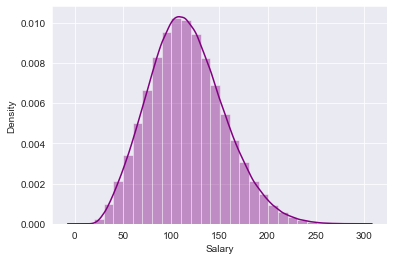

In [28]:
sns.set_style('darkgrid')
sns.distplot(train_df.salary,bins=30,color = 'purple')
plt.xlabel('Salary')

From differnt kind of analysis on Salary variable it is evident there is a possibilty of outliers.So it is required to check the same.

#### 5.4. Examine and Identify Outliers in Salary data through IQR method

In [29]:
sal_desc= train_df.salary.describe()
print(sal_desc)

count    1000000.000000
mean         116.061818
std           38.717936
min            0.000000
25%           88.000000
50%          114.000000
75%          141.000000
max          301.000000
Name: salary, dtype: float64


In [30]:
IQR = sal_desc['75%'] - sal_desc["25%"]
upper_bound= sal_desc['75%'] + IQR
lower_bound = sal_desc['25%'] - IQR
print(" Salary value greater than {} and less than {} are suspected outliers. ".format(upper_bound,lower_bound))

 Salary value greater than 194.0 and less than 35.0 are suspected outliers. 


In [31]:
# Count of potential lower outlier
train_df.loc[train_df.salary < 35.0,'jobType'].value_counts() 

JANITOR           4974
JUNIOR             181
SENIOR               4
CTO                  1
MANAGER              1
VICE_PRESIDENT       1
Name: jobType, dtype: int64

From above analysis Salary of a CTO is less than 35K USD which is suspicious.

In [32]:
train_df[(train_df.salary < 35.0) & (train_df.jobType =='CTO')]

,jobId,companyId,jobType,degree,major,industry,yearsExperience,milesFromMetropolis,salary
652076,JOB1362685059763,COMP25,CTO,HIGH_SCHOOL,NONE,AUTO,6,60,0


This data seems invalid as salry can't be 0. Now it is required to find out if any other records are there for which salary is '0' (zero).

In [33]:
train_df[train_df.salary == 0]

,jobId,companyId,jobType,degree,major,industry,yearsExperience,milesFromMetropolis,salary
30559,JOB1362684438246,COMP44,JUNIOR,DOCTORAL,MATH,AUTO,11,7,0
495984,JOB1362684903671,COMP34,JUNIOR,NONE,NONE,OIL,1,25,0
652076,JOB1362685059763,COMP25,CTO,HIGH_SCHOOL,NONE,AUTO,6,60,0
816129,JOB1362685223816,COMP42,MANAGER,DOCTORAL,ENGINEERING,FINANCE,18,6,0
828156,JOB1362685235843,COMP40,VICE_PRESIDENT,MASTERS,ENGINEERING,WEB,3,29,0


There are 5 records with Salary as 0 (Zero).

In [34]:
### Let's investigate on suspected upper outlier
train_df.loc[train_df.salary > 194.0,'jobType'].value_counts()

CEO               11197
CTO                6556
CFO                6426
VICE_PRESIDENT     3406
MANAGER            1571
SENIOR              674
JUNIOR              268
Name: jobType, dtype: int64

Salary of few JUNIOR present in upper outlier range. More analysis required for this.

In [35]:
train_df[(train_df.salary > 194.0) & (train_df.jobType =='JUNIOR')]

,jobId,companyId,jobType,degree,major,industry,yearsExperience,milesFromMetropolis,salary
488,JOB1362684408175,COMP51,JUNIOR,DOCTORAL,PHYSICS,OIL,18,8,196
1222,JOB1362684408909,COMP40,JUNIOR,MASTERS,COMPSCI,OIL,24,5,225
14347,JOB1362684422034,COMP30,JUNIOR,DOCTORAL,ENGINEERING,FINANCE,21,24,202
14998,JOB1362684422685,COMP59,JUNIOR,DOCTORAL,LITERATURE,OIL,23,1,195
21013,JOB1362684428700,COMP41,JUNIOR,MASTERS,BUSINESS,OIL,20,12,216
...,...,...,...,...,...,...,...,...,...
977583,JOB1362685385270,COMP27,JUNIOR,BACHELORS,ENGINEERING,OIL,19,11,217
978326,JOB1362685386013,COMP47,JUNIOR,DOCTORAL,NONE,OIL,23,19,198
978620,JOB1362685386307,COMP35,JUNIOR,DOCTORAL,BUSINESS,FINANCE,24,41,212
995904,JOB1362685403591,COMP2,JUNIOR,MASTERS,BUSINESS,WEB,22,8,196


In [36]:
train_df[(train_df.salary > 194.0)].max()

jobId                  JOB1362685407657
companyId                         COMP9
jobType                  VICE_PRESIDENT
degree                             NONE
major                           PHYSICS
industry                            WEB
yearsExperience                      24
milesFromMetropolis                  99
salary                              301
dtype: object

While analyzing data , 5 rows having Salary value as '0' (Zero). This is unusual and suspected missing data. Those should be removed from training data.

Analyzing data greater than upper bound , it seems all are valid data.


#### 5.5. Removing Zero Salary data from Training Set

In [37]:
train_df = train_df[train_df.salary > 0]

In [38]:
train_df.count()

jobId                  999995
companyId              999995
jobType                999995
degree                 999995
major                  999995
industry               999995
yearsExperience        999995
milesFromMetropolis    999995
salary                 999995
dtype: int64

<a id='dv'></a>
### 6. Data Visualization : Graphical way For More Insights

#### 6.1. Defining a Function to visulize Training Set Data :

In [39]:
def plot_feature(df, col):
    ''' 
    It is a function to plot each features; df => training set as input, col=> Column label 
    '''
    sns.set_style('whitegrid')
    plt.figure(figsize = (14,6))
    plt.subplot(1,2,1)
    
    if df[col].dtype == 'int64':
        df[col].value_counts().sort_index().plot()
    else:
        sns.countplot(x=col,data=df,linewidth=3,edgecolor='black',palette='Set3',order = df[col].value_counts().index)  
    plt.xticks(rotation=45)
    plt.xlabel(col)
    plt.ylabel('Counts')    
    plt.subplot(1,2,2)
    
    
    if df[col].dtype == 'int64' or col == 'companyId':
        mean1 = df.groupby(col)['salary'].mean()
        std1 = df.groupby(col)['salary'].std() 
        mean1.plot()          
        plt.fill_between(range(len(std1.index)), mean1.values-std1.values, mean1.values+std1.values, alpha = 0.1)
                                             
    else:
        sns.boxplot(x=col,y='salary',data=df,linewidth=3,palette='Set3',order = df[col].value_counts().index)
    
    
    plt.xticks(rotation=45)
    plt.ylabel('Salary')
    plt.show()
     

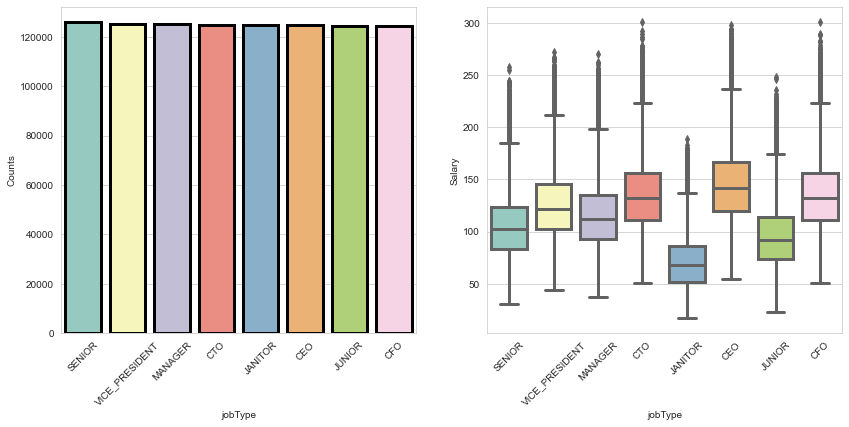

In [40]:
plot_feature(train_df,'jobType')

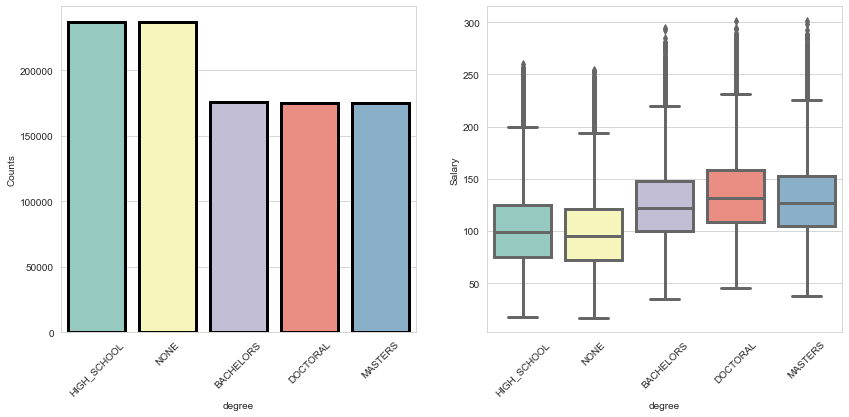

In [41]:
plot_feature(train_df,'degree')

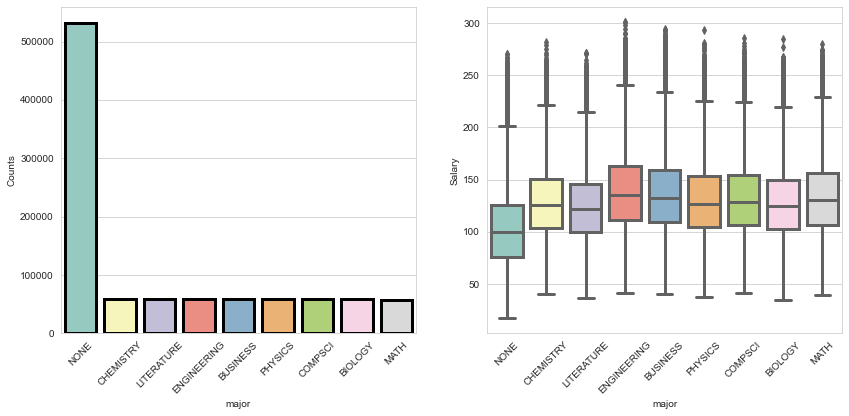

In [42]:
plot_feature(train_df,'major')

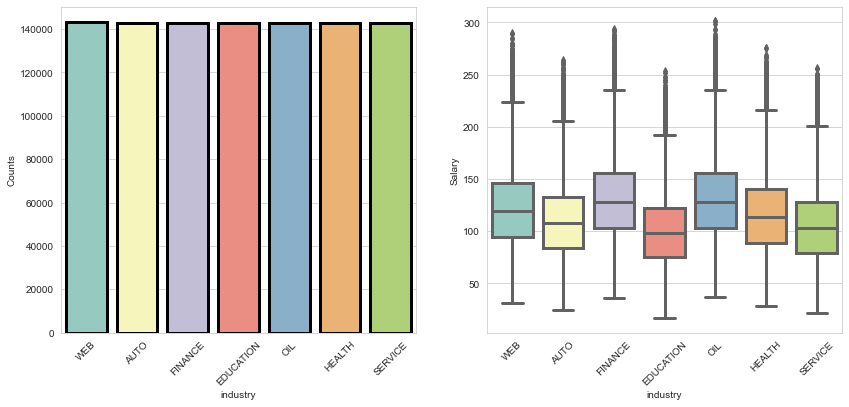

In [43]:
plot_feature(train_df,'industry')

In the training set all the 7 industries has similar distribution and to understand its relation with Salary further analysis is required.Same counclusion is applied for 8 different jobtypes. Further analysis required to comment on its impact on salary.

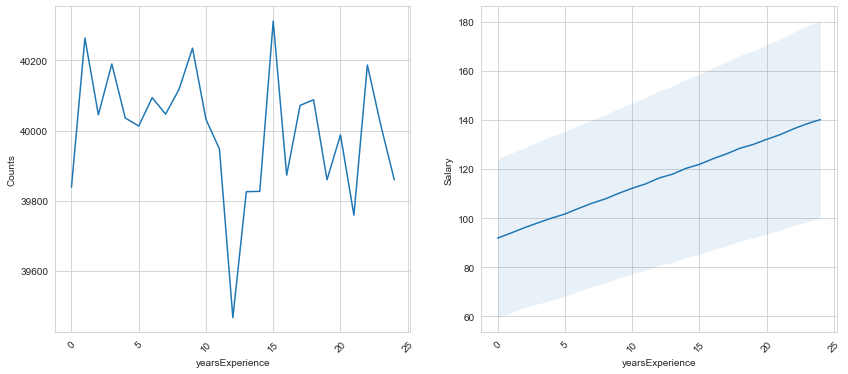

In [44]:
plot_feature(train_df,'yearsExperience')

From the right hand trend , it is shown that years of experience is positively impacting the Salary.

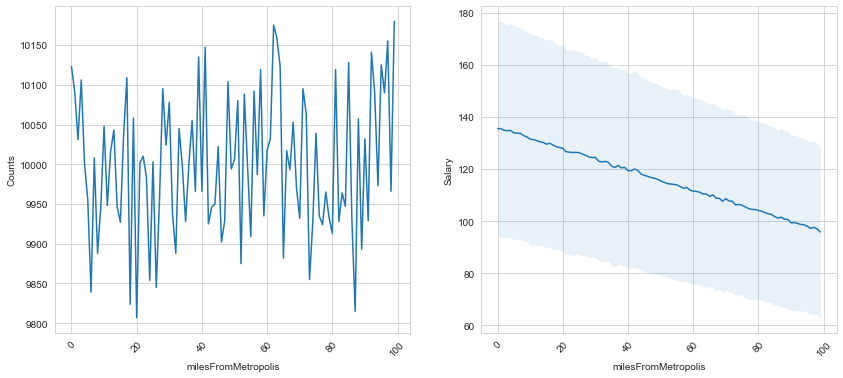

In [45]:
plot_feature(train_df,'milesFromMetropolis')

Here, distance is somehow negatively related to salary from the right hand side visualization.

#### 6.2. Correlation between selected features and Heat Map Visualization

This measure will give an insights about the relation among different features. it will even provide an understanding of impact of these on Salary ( target value). First two utility functions has been defined to include all categorical columns in correlation value claculation. 

In [46]:
def convert_cat(df,col):
    '''
    It is a function to convert the type of column as Categorical Column
    
    '''
    df[col] = df[col].astype('category')

In [47]:
def encode_label(df,col):
    '''
    It is a function to encode categories using average salary of each category to replace label
    '''
    cat_dict= {}
    cats = df[col].cat.categories.tolist()
    for cat in cats:
        cat_dict[cat] = train_df[train_df[col] == cat]['salary'].mean()
    df[col] = df[col].map(cat_dict)

In [48]:
for col in train_df.columns:
    if train_df[col].dtype.name == 'object' and col != 'jobId':
        convert_cat(train_df,col)
        encode_label(train_df,col)
        train_df[col] = train_df[col].astype('int64')

#### How important each feature with respect to target variable?

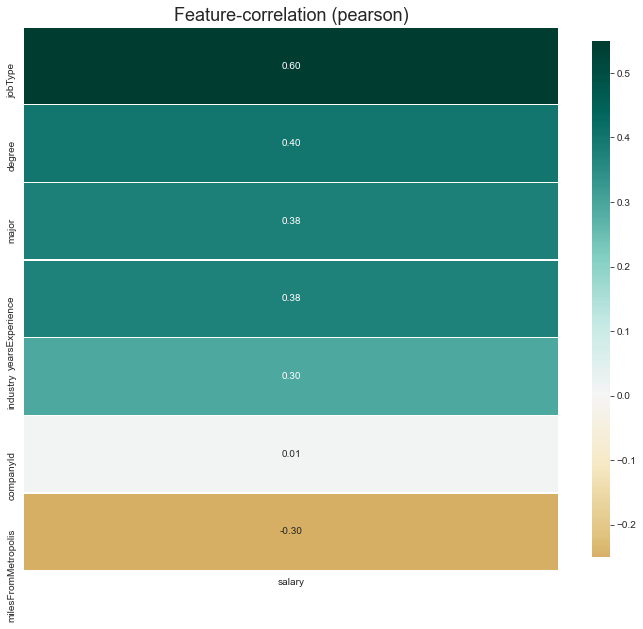

In [49]:
klib.corr_plot(train_df, target='salary', method='pearson')

It is evident that jobtype is apparently most important factor for salary. Degree, Subject expertise,Experience,industry,distance are also contributing in a significant way. It is also evident that companyID may have very less impact on Salary based on training data and algoritham used to find out corretaion value.

#### How all the features are related to each other ?

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5]),
 <a list of 8 Text major ticklabel objects>)

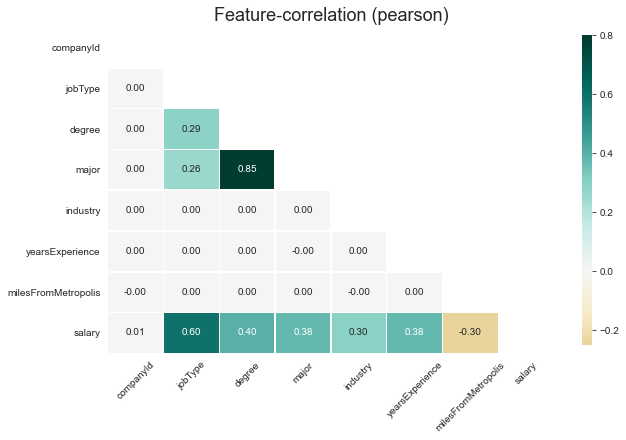

In [50]:
klib.corr_plot(train_df, annot=True, method='pearson', figsize=(10,6))
plt.xticks(rotation=45)

From above matrix, it can be seen that degree and major colum are highly correlated while job type is also have some relation to major and degree. For other features, these are almost independently contributing to decide salary value.

This is an exploratory data analysis of Salary prediction dataset. It will act as an catalyst to design final model for Salary prediction in Part-II of this model buliding exercise. based on the above anaylysis below regression model can be recommended as a probable model algorithm.

1. Linear Regression
2. RandomForest 
3. GradienBoost

In Part II - Data Feature Engineering in detail and Modelling and its Evaluation will be covered.

                          ---------------- End of Part-I-------------------